# Spotify songs recommendation System

In [2]:
!pip install datapane chart_studio

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.4/64.4 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.0/11.0 MB 10.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.8/210.8 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.6/143.6 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 5.5 MB/s eta 0:00:00
  Created wheel for micawber: filename=micawber-0.5.5-py3-none-any.whl size=22455 sha256=ad5fc9452af7f6a8aa54c1d11ce00a86e7f5bf23bdfb4aa6367f450fc4cc6b0f
  Stored in directory: /Users/bhkakuma/Library/Caches/pip/wheels/2c/1c/73/5f366d58c794704ffb86c49d1ab4cb72c7433b68e710ca40f0
Successfully built micawber
  Attempting uninstall: pandas
    Found existing installation: pandas 2.1.0
    Uninstalling pandas-2.1.0:
      Successfully uninstalled pandas-2.1.0


In [4]:
# Standard library imports
import os

# Third-party imports
import chart_studio
import chart_studio.plotly as py
import chart_studio.tools
import datapane as dp
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import spotipy
import pandas as pd
import plotly.express as px
import datapane as dp

# Set plot parameters
plt.rcParams.update({'font.size': 22})
%matplotlib inline

# Securely load credentials from environment variables
username = os.getenv('CHART_STUDIO_USERNAME', 'default_username')
api_key = os.getenv('CHART_STUDIO_API_KEY', 'default_api_key')
chart_studio.tools.set_credentials_file(username=username, api_key=api_key)

In [5]:
# Loading data
spotify_data = pd.read_csv('./data/data.csv.zip')
genre_data = pd.read_csv('./data/data_by_genres.csv')
data_by_year = pd.read_csv('./data/data_by_year.csv')

# Display the first 10 rows of the spotify data
spotify_data.head(10)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
5,0.1960,1921,0.579,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.697,395076,0.346,0,4pyw9DVHGStUre4J6hPngr,0.168000,2,0.130,-12.506,1,Gati Mardika,6,1921,0.0700,119.824
6,0.4060,1921,0.996,['John McCormack'],0.518,159507,0.203,0,5uNZnElqOS3W4fRmRYPk4T,0.000000,0,0.115,-10.589,1,The Wearing of the Green,4,1921,0.0615,66.221
7,0.0731,1921,0.993,['Sergei Rachmaninoff'],0.389,218773,0.088,0,02GDntOXexBFUvSgaXLPkd,0.527000,1,0.363,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",2,1921,0.0456,92.867
8,0.7210,1921,0.996,['Ignacio Corsini'],0.485,161520,0.130,0,05xDjWH9ub67nJJk82yfGf,0.151000,5,0.104,-21.508,0,La Mañanita - Remasterizado,0,1921-03-20,0.0483,64.678
9,0.7710,1921,0.982,['Fortugé'],0.684,196560,0.257,0,08zfJvRLp7pjAb94MA9JmF,0.000000,8,0.504,-16.415,1,Il Etait Syndiqué,0,1921,0.3990,109.378


In [6]:
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [7]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [8]:
data_by_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


## Exploratory Data Analysis

/var/folders/7s/wvl73lz96tb3mvfs7k8w_3700000gn/T/ipykernel_41338/129732028.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(spotify_data['popularity'])
/Users/bhkakuma/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/bhkakuma/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating 

<Axes: xlabel='popularity', ylabel='Density'>

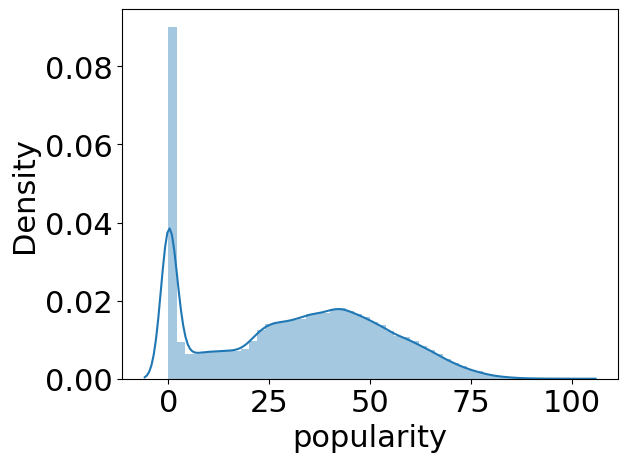

In [9]:
sns.distplot(spotify_data['popularity'])

### Music Over Time

In [10]:


# Function to determine the decade of a given year
def calculate_decade(year):
    return f"{(year // 10) * 10}s"


# Applying the function to the spotify dataset to add a 'decade' column
spotify_data['decade'] = spotify_data['year'].apply(calculate_decade)


In [13]:
# Selecting sound features to plot
audio_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']

# Creating a line plot for audio features over the years
yearly_trends_figure = px.line(data_by_year, x='year', y=audio_features)

# Display the plot
yearly_trends_figure.show()

# Creating a report with the plot
report = dp.Report(dp.Plot(yearly_trends_figure))

In [14]:
fig = px.line(data_by_year, x='year', y='tempo')
fig.show()
report = dp.Report(dp.Plot(fig) )

### Characteristics of Different Genres

In [15]:
top10_genres = genre_data.nlargest(10, 'popularity')

In [17]:
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()
report = dp.Report(dp.Plot(fig) )

## Clustering Genres

In [19]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np

# Function for clustering genres
def cluster_genres(data, num_clusters=10):
    pipeline = Pipeline([
        ('scaler', StandardScaler()), 
        ('kmeans', KMeans(n_clusters=num_clusters))
    ])
    numeric_data = data.select_dtypes(np.number)
    pipeline.fit(numeric_data)
    return pipeline.predict(numeric_data)

# Function to apply t-SNE and create a projection dataframe
def apply_tsne_and_project(data, n_components=2, verbose=2):
    tsne_pipeline = Pipeline([
        ('scaler', StandardScaler()), 
        ('tsne', TSNE(n_components=n_components, verbose=verbose))
    ])
    tsne_results = tsne_pipeline.fit_transform(data.select_dtypes(np.number))
    projection_df = pd.DataFrame(columns=['x', 'y'], data=tsne_results)
    return projection_df

# Clustering genres
genre_data['cluster'] = cluster_genres(genre_data)


/Users/bhkakuma/Library/Python/3.9/lib/python/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [20]:
# Applying t-SNE and creating a projection dataframe
projection = apply_tsne_and_project(genre_data)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.144s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.035s
[t-SNE] Iteration 50: error = 78.8311310, gradient norm = 0.0265263 (50 iterations in 1.104s)
[t-SNE] Iteration 100: error = 76.2449112, gradient norm = 0.0013298 (50 iterations in 0.495s)
[t-SNE] Iteration 150: error = 76.1403656, gradient norm = 0.0005134 (50 iterations in 0.473s)
[t-SNE] Iteration 200: error = 76.1152878, gradient norm = 0.0001761 (50 iterations in 0.468s)
[t-SNE] Iteration 250: error = 76.1062164, gradient norm = 0.0000883 (50 iterations in 0.425s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106216
[t-SNE] Iteration 300: erro

In [23]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()


report = dp.Report(dp.Plot(fig))


## Clustering Songs

In [25]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np

# Function for clustering genres
def cluster_genres(data, num_clusters=10):
    pipeline = Pipeline([
        ('scaler', StandardScaler()), 
        ('kmeans', KMeans(n_clusters=num_clusters))
    ])
    numeric_data = data.select_dtypes(np.number)
    pipeline.fit(numeric_data)
    return pipeline.predict(numeric_data)

# Function to apply t-SNE and create a projection dataframe
def apply_tsne_and_project(data, n_components=2, verbose=2):
    tsne_pipeline = Pipeline([
        ('scaler', StandardScaler()), 
        ('tsne', TSNE(n_components=n_components, verbose=verbose))
    ])
    tsne_results = tsne_pipeline.fit_transform(data.select_dtypes(np.number))
    projection_df = pd.DataFrame(columns=['x', 'y'], data=tsne_results)
    return projection_df

# Clustering genres
genre_data['cluster'] = cluster_genres(genre_data)



[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s


/Users/bhkakuma/Library/Python/3.9/lib/python/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 1526456.675401628.
Iteration 1, inertia 1155329.8538753511.
Iteration 2, inertia 1110960.129536823.
Iteration 3, inertia 1091071.0441235153.
Iteration 4, inertia 1078240.4026914747.
Iteration 5, inertia 1072933.4191358606.
Iteration 6, inertia 1069590.7056064757.
Iteration 7, inertia 1067344.4519952396.
Iteration 8, inertia 1065739.5005125727.
Iteration 9, inertia 1064523.3107723189.
Iteration 10, inertia 1063481.1241756724.
Iteration 11, inertia 1062529.4220368094.
Iteration 12, inertia 1061659.9582800418.
Iteration 13, inertia 1060923.0274946662.
Iteration 14, inertia 1060307.2923590573.
Iteration 15, inertia 1059791.8610985263.
Iteration 16, inertia 1059342.6021215331.
Iteration 17, inertia 1058896.941705384.
Iteration 18, inertia 1058365.1831817173.
Iteration 19, inertia 1057769.2630022734.
Iteration 20, inertia 1057243.0159148064.
Iteration 21, inertia 1056420.8943426271.
Iteration 22, inertia 1055053.9851685679.
Iteration 23, inertia 1

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=20, verbose=2))],
         verbose=True)

In [26]:

# Applying t-SNE and creating a projection dataframe
projection = apply_tsne_and_project(genre_data)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

In [27]:
spotify_data['cluster_label'] = projection

In [28]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
import pandas as pd
import plotly.express as px
import datapane as dp

# Assuming spotify_data and its cluster labels are already defined
# Define the data to be processed
X = spotify_data.select_dtypes(include=[np.number])

# Create a pipeline for PCA
pca_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('PCA', PCA(n_components=2))
])

# Apply PCA to the data
song_embedding = pca_pipeline.fit_transform(X)

# Create a dataframe for the projection
projection = pd.DataFrame(song_embedding, columns=['x', 'y'])
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']




In [30]:
# Create a scatter plot using Plotly Express
fig = px.scatter(projection, x='x', y='y', color='cluster', 
                 hover_data=['title'], title="PCA Projection of Songs")

# Display the plot
fig.show()

# Create a Datapane report
report = dp.Report(dp.Plot(fig))

## Building a Content-Based Recommender System

In [32]:
from spotipy.oauth2 import SpotifyClientCredentials
import spotipy
from collections import defaultdict
import pandas as pd

# Initialize Spotify client
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='a5f717c39c0d452a8f23335b60a5272f',
                                                           client_secret='18f36bc7c4e94edd871e9edb26fdeeea'))

def find_song(title, year):
    """
    Search for a song by title and year, and return its details and audio features in a DataFrame.
    """
    # Use defaultdict to handle missing keys gracefully
    song_details = defaultdict(lambda: None)

    # Search for the song
    search_query = f"track: {title} year: {year}"
    search_results = sp.search(q=search_query, limit=1)

    # Check if any song was found
    if not search_results['tracks']['items']:
        return None

    # Extract track details
    track_info = search_results['tracks']['items'][0]
    track_id = track_info['id']
    audio_features = sp.audio_features(track_id)[0]

    # Populate song details
    song_details['name'] = title
    song_details['year'] = year
    song_details['explicit'] = int(track_info['explicit'])
    song_details['duration_ms'] = track_info['duration_ms']
    song_details['popularity'] = track_info['popularity']

    # Add audio features
    for key, value in audio_features.items():
        song_details[key] = value

    return pd.DataFrame([song_details])



In [38]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    song_filter = (spotify_data['name'] == song['name']) & (spotify_data['year'] == song['year'])
    if song_filter.any():
        return spotify_data[song_filter].iloc[0]
    else:
        return find_song(song['name'], song['year'])

        

def get_mean_vector(song_list, spotify_data):
    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue

        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    if not song_vectors:
        return None

    song_matrix = np.array(song_vectors)
    return np.mean(song_matrix, axis=0)



def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        

import numpy as np
from scipy.spatial.distance import cdist

def recommend_songs(song_list, spotify_data, n_songs=10):
    """
    Recommend songs based on a list of input songs.

    Args:
    song_list (list): A list of song dictionaries.
    spotify_data (DataFrame): A DataFrame containing Spotify songs data.
    n_songs (int): The number of songs to recommend.

    Returns:
    list: A list of recommended song dictionaries.
    """
    # Extract relevant metadata
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    # Compute the mean vector for the input songs
    song_center = get_mean_vector(song_list, spotify_data)
    if song_center is None:
        return []

    # Scale the data and calculate distances
    scaler = projection.named_steps['scaler']
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')[0]

    # Get the indices of songs with the smallest distances
    indices = np.argsort(distances)[:n_songs]

    # Select and filter recommended songs
    recommended_songs = spotify_data.iloc[indices]
    recommended_songs = recommended_songs[~recommended_songs['name'].isin(song_dict['name'])]

    # Convert recommended songs to list of dictionaries
    return recommended_songs[metadata_cols].to_dict(orient='records')




In [41]:
recommend_songs([{'name': 'Beat It', 'year':1982}],  spotify_data)

/Users/bhkakuma/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:464: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'Johnny B. Goode - 2002 Remaster',
  'year': 1983,
  'artists': "['Peter Tosh', 'John Benitez']"},
 {'name': 'Toxic', 'year': 2003, 'artists': "['Britney Spears']"},
 {'name': 'Ahora Te Puedes Marchar',
  'year': 1987,
  'artists': "['Luis Miguel']"},
 {'name': 'Ma Baker', 'year': 1977, 'artists': "['Boney M.']"},
 {'name': "Let's Get Loud", 'year': 1999, 'artists': "['Jennifer Lopez']"},
 {'name': 'Groove Is in the Heart', 'year': 1990, 'artists': "['Deee-Lite']"},
 {'name': 'The Boss', 'year': 1979, 'artists': "['Diana Ross']"}]